# Abstract
In this project, I experiment with the network designing/modification of DOPE. DOPE stands for Deep Object Pose Estimation. It is a 6 DoF pose estimator built with approximately 92 conv layers. I wanted to learn more about designing such elaborate neural networks by trying to play around with the architecture of original DOPE. This project is the result of 1 months work, where I have experimented with more than 20 different versions. I could not present my findings or learnings from each of them so in this file I present a few of them. First, I present the effects of transfer learning. Then I introduce DOPE_2, DOPE_2.1, DOPE_2.2 which are modifications of original DOPE architectures. Finally, I present a network called ResNetPose, which is a pose estimator like DOPE but built on ResNet34 and has residual connections with-in each cascade. For each presented network, I demonstrate an estimation of their performance. At the end, I conclude with my observations and learnings in the discussion section.

# Introduction:
Six degree of freedom (6 DoF) pose estimation of objects from images is a well defined problem in computer vision. "6D pose estimation is the task of detecting the 6D pose of an object, which include its location and orientation. This is an important task in robotics, where a robotic arm needs to know the location and orientation to detect and move objects in its vicinity successfully. This allows the robot to operate safely and effectively alongside humans. The awareness of the position and orientation of objects in a scene is sometimes referred to as 6D, where the D stands for degrees of freedom pose." [definition reference](https://paperswithcode.com/task/6d-pose-estimation)  

Among various CNN based approaches that are available, I am interested in DOPE. DOPE stands for deep object pose estimation [github](https://github.com/NVlabs/Deep_Object_Pose). It is reported to outperform (in terms of accuracy) PoseCNN which is one of the top performing pose estimators. The reason for choosing DOPE is purely educational. I am familiar with working with DOPE and wanted to learn more about the network architecture, change in behavior over training time etc. 

At first, my objective was to come up with a better/more efficient/faster runtime architecture so that I can do a publication. After 4 weeks of continuous working on this, I realized that coming up with such a solution is too ambitious an objective for now. Instead, over this period I acquired a lot of skills and knowledge about practically working with Deep Learning. I decided to make my project report on these observations.




# Literature Review:
[DPOD](https://arxiv.org/pdf/1902.11020.pdf) (Dense Pose Object Detector) is the current leader in 6DoF object pose estimator. They provide a very nice and concise literature review on the 6DoF object pose estimation problem. Instead of spending time paraphrasing their writing for a literature review section, I'll just refer you to their "Related Works" section. If you are interested please check it out.

Paper link: https://arxiv.org/pdf/1902.11020.pdf

# Experiments
In this section, I demonstrate a small subset of the experiments that I did over the past month. While most of my experiments resulted in not being able to achieve any convergence in training, I did observe some interesting behaviors and overcame some key challenges. I'll try to focus on them in this section.

### Load Dependencies

In [1]:
import cv2
import matplotlib.pyplot as plt
import torch
from detector import *
from dope_utilities import *

### Load Input Image
Loading test image. There are 16 options. Choose index in the range 0 to 16 for testing out different input test image.

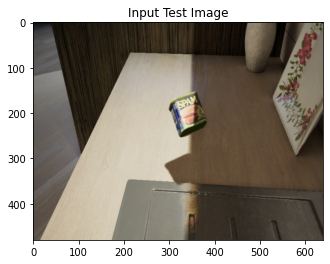

In [2]:
in_img_index = 0 # Edit this to select different image (0-15)

data_path = 'Dataset/dev_batch/'
in_img, beliefsTruths, _ = get_truth_maps(data_path, in_img_index)
width,height = 480,640
in_img = cv2.resize(in_img, (height, width))
plt.imshow(in_img)
plt.title('Input Test Image');

epoch = 60
gpu_id = 1 # which gpu to use
device = torch.device("cuda:"+str(gpu_id))
name = 'meat' # Not useful

### Ground Truth Belief Map Visualization
For reference this is how the predicted final belief map images are suppose to look like:

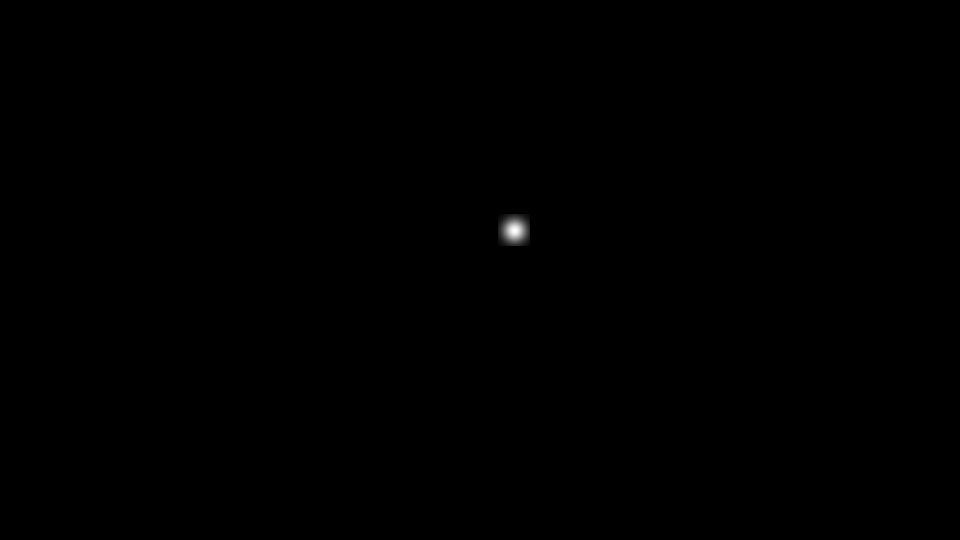

In [3]:
# Visualization of ground truth belief maps
beliefsTruths[8] # range (0-8)

## First Wall of Challenge: Training Time
DOPE network is very big. In its original form, it is around 92 layers deep. Training this network properly for any single object takes a long time. So, early on I had to decide which single object I will train my experimental networks for. I decided to work with the "spam meat" can. From the [FAT](https://research.nvidia.com/publication/2018-06_Falling-Things) dataset, I had access to 3K images of the meat-can object. Training DOPE or my experimental networks on these 3k images for 60 epochs would take 3-6 hours on a single Titan-Xp. This made experimenting with different network architectures and other hyper parameters extremely difficult. Over the past month, I probably have experimented with more than 20-30 versions of experimental networks, most of the time resulting in complete failure to converge. Often times I had to run my desktop 24 hours a day, for several days. Thus, my first challenge was how to overcome this very long training time problem.  

The solution was pretty simple. I made a very small dataset by taking only 16 images from the 3k image dataset. I call this tiny subset as my dev_batch (development batch dataset). Instead of visualizing loss curve by training on 3k images, I decided to overfit my networks on only 16 images. I decided to visualize the feature maps of the final output layer while trying to overfit my models. The final output feature maps are, in short, suppose to predic a binary mask image. Each mask image will represent the estimated location of each of the vertices of the predicted 3D cuboid around the target object. So, the diagnosis rule was simple: if by 60 epochs, I don't see the experimental network starting to come up with sensible structure in the final feature maps, then I decide this network won't work/converge no matter what I do. I ran many experiments and empirically found this reasoning to be true every time. The logic was that if the network can't even overfit with a tiny dataset, it won't be able to handle the full 3k image dataset. Thus I won't waste time trying to train it for long time.  

This strategy proved to be key in getting this project forward. I was stuck for days. After this strategy I could finally move forward with my experiments. I'll demonstrate this in later stages of this project report. In the following section I report only a few of my experimental models. After I had finalized these architectures by using dev_batch, I trained them on 3k images. Following networks are all trained on 3k images.  

## Demonstrating the Usefulness of dev_batch
In this section, I show a little demonstration of how training a network on dev_batch gives a great idea about the appropriateness of the chosen learning rate and network design.
I start off with the original architecture of DOPE. In the following figures, I show the predicted belief maps by the network after it was trained on only 16 images. First I train the network with original learning rate of 0.0001. As you can see, in less than 4 minutes I can see that the network is starting to learn the correct patterns.  
The left column represents the output belief maps produced by the network. On the right, the images are overlaid images, in which the predicted belief maps are overlaid on top of the input image. For simplicity, it can be said that the right column represents where the network predicts the 8 vertices and 1 centroid of the target object are located.

Loading model 'weights/dope1_meat_16img/net_epoch_60.pth'...
    Model loaded in 5.001190662384033 seconds.


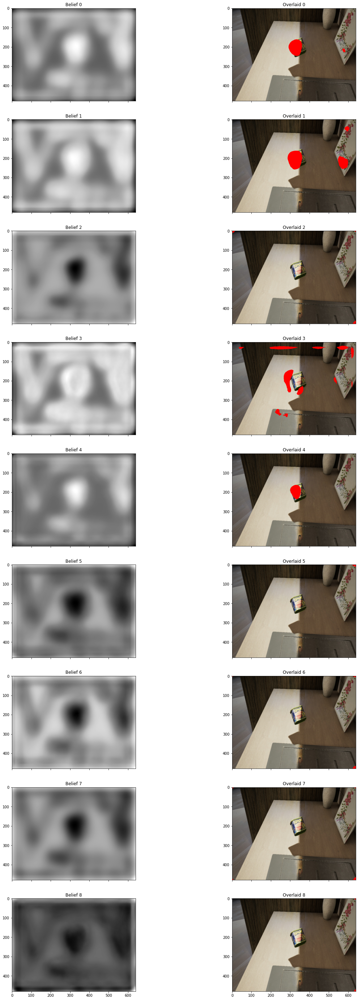

In [4]:
# DOPE - trained on 16 image dev_batch with original learning rate
network="DOPE"
net_path = "weights/dope1_meat_16img/net_epoch_" + str(epoch) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_1 = model.net

cascade_to_viz = -1 # Visualizing cascade 6's output. Feel free to change (-1 to -6)
image_tensor = transform(in_img)
image_torch = image_tensor.to(device).unsqueeze(0)

out, seg = model_1(image_torch)
beliefs_1 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only

viz_belief_maps(beliefs_1, in_img)

Now, I train a experimental network "ResNetPose" on this dev_batch. I'll explain the details of this network later. As you can see the network isn't producing anything discernible at the final output maps. I also repeated the training on 3k images. The produced belief maps are similar which I'll show later. Both output-sets represent the same message: the network won't converge and something is wrong. But with dev_batch, I can find that out with several 4 minute sessions (trying different learning rate, slight network modifications). Otherwise, to reach the same conclusion with 3k images it would take me 1-2 days of work. Sadly, I lost first 1.5 weeks like that.  
Working with dev_batch provides a nice platform to set the two extremes of the learning rate. I learned the hard way that this is the number one hyper parameter that I must determine. Working with dev_batch made it possible in this project.

Loading model 'weights/ResNetPose_meat_16img/net_epoch_60.pth'...
Loading pretrained ResNet34: True
Freezing entire ResNet34 except layer 3 and 4...
    Model loaded in 4.463048458099365 seconds.


/home/mukit/PycharmProjects/ResPose/venv/lib/python3.6/site-packages/torch/nn/functional.py:2506: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


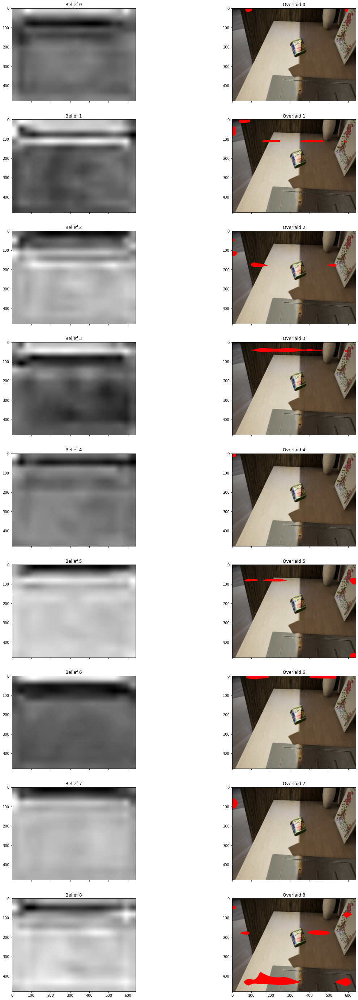

In [5]:
# ResNetPose - an experimental network, trained on 16 image dev_batch
network="ResNetPose"
net_path = "weights/ResNetPose_meat_16img/net_epoch_" + str(epoch) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_1 = model.net

cascade_to_viz = -1 # Visualizing cascade 6's output. Feel free to change (-1 to -6)
image_tensor = transform(in_img)
image_torch = image_tensor.to(device).unsqueeze(0)

out, seg = reshape_maps(model_1(image_torch))
beliefs_1 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only

viz_belief_maps(beliefs_1, in_img)

## 1 & 2. Usage of Pretrained VGG / Progression of Training
When I had first cloned the project (1 year back) the training [code was hardcoded](https://github.com/NVlabs/Deep_Object_Pose/commit/5224aaff3e38c218e78add4b1cf4e4dc67c9d6df) to not use pretrained VGG weights. After starting this project I realized this problem. I wanted to experiment with the effects of training with and without pretrained VGG weights.

Both networks were trained on 3k image dataset.


### My Video Links:
DOPE Pose Estimation overview: [video](https://youtu.be/ZJ2CaF6x5eA)  
DOPE Original Architecture Overview: [video](https://youtu.be/0ajzJez4-rA)  


### Original DOPE Network:
![Original DOPE](docs/DOPE_diagram.png)

### Load Trained Networks
Loading network models. model_1 is for DOPE without pretrained VGG net and model_2 is with pretrained VGG weights.

In [6]:
# DOPE - loading weights trained WITHOUT pretrained VGG
epoch = 60
network="DOPE"
net_path = "weights/dope1_meat/net_epoch_" + str(epoch) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_1 = model.net

# DOPE - loading weights trained WITH pretrained VGG
network="DOPE"
net_path = 'weights/dope1.1_meat/net_epoch_' + str(epoch) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_2 = model.net

print(model_2.eval())

dope_param_count = count_parameters(model_2)
print('Parameter count: ' + str(dope_param_count))

Loading model 'weights/dope1_meat/net_epoch_60.pth'...
    Model loaded in 2.1845357418060303 seconds.
Loading model 'weights/dope1.1_meat/net_epoch_60.pth'...
    Model loaded in 2.2522575855255127 seconds.
DopeNetwork(
  (vgg): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding

### Vertex Prediction Visualization
Visualizing vertex detection performance on input image. The images are overlaid images, in which the groundtruth/predicted belief maps are overlaid on top of the input image. First a binary mask is created from the belief maps. In the mask image, the pixels with value 1 correspond to pixels at which the networks determines the probability of a vertex/centroid being present is above 90%. In the overlaid images these pixels are colored red.  
The left-most column shows the overlaid images corresponding to the groundtruth belief maps. The second and third columns correspond to predictions by model_1 and model_2 respectively.

DOPE with no pretrained vgg, Epoch: 60
DOPE WITH pretrained vgg, Epoch: 60


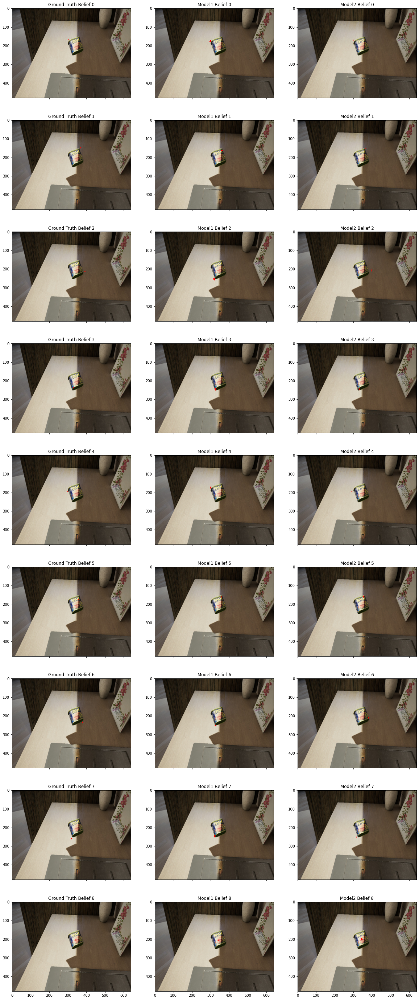

In [7]:
cascade_to_viz = -1 # Visualizing cascade 6's output. Feel free to change (-1 to -6)
image_tensor = transform(in_img)
image_torch = image_tensor.to(device).unsqueeze(0)

out, seg = model_1(image_torch)
beliefs_1 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only

out, seg = model_2(image_torch)
beliefs_2 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only


compare_belief_maps(beliefsTruths, beliefs_1, beliefs_2, in_img)
print(f"DOPE with no pretrained vgg, Epoch: {epoch}")
print(f"DOPE WITH pretrained vgg, Epoch: {epoch}")

### Predicted Belief Map Analysis
In this section I present the ground truth belief maps and their predicted versions by both model_1 and model_2.
First let's visualize how ground truth belief maps look like.

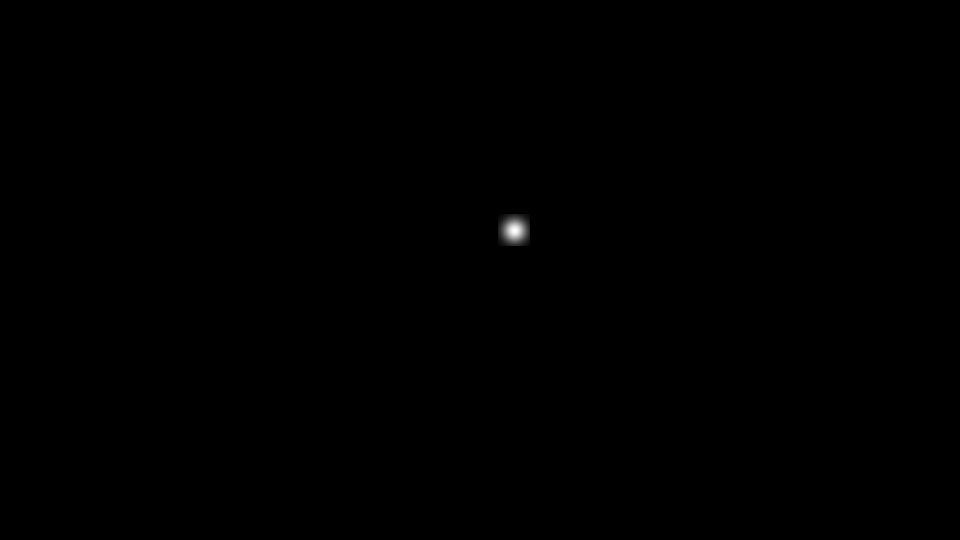

In [8]:
# Visualization of ground truth belief maps
beliefsTruths[8] # range (0-8)

Visualizing belief maps generated by trained DOPE network without pretrained VGG weights.
As you can see in the belief maps the predictions of the model_1 has a lot of "confusions".

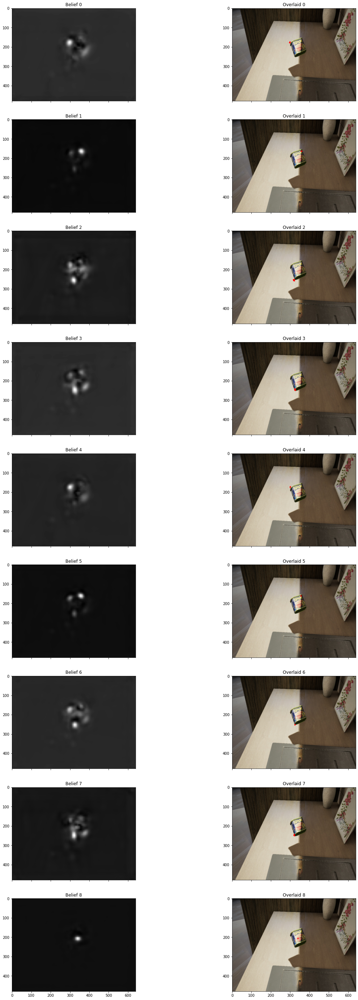

In [9]:
 viz_belief_maps(beliefs_1, in_img)

Visualizing belief maps generated by DOPE trained WITH pre-trained VGG weights.
From the belief maps it can be seen that model_2 is much confident in its predictions; almost as good as the groundtruths.

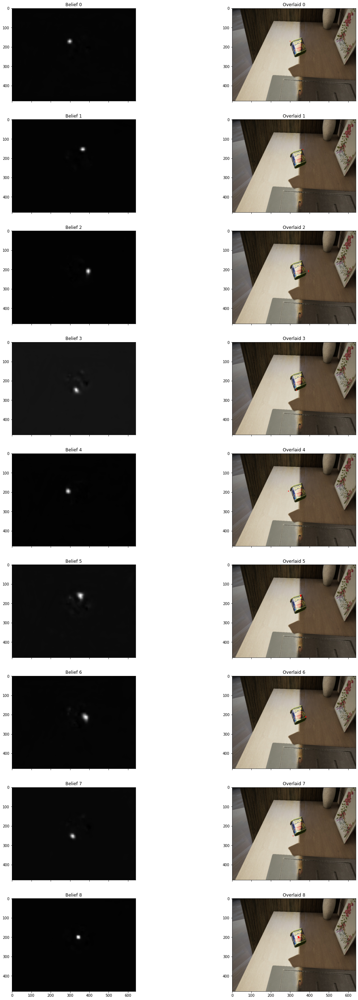

In [10]:
 viz_belief_maps(beliefs_2, in_img)

So from above visualization it is clear that starting the training out with pretrained VGG weights results in a network that is much easier to train. To understand better why is it easier to train (easier to converge) change the epoch settings above and run the visualization codes again.
So the conclusion drawn from this experiment is that from now on every network that I experiment with will use pretrained weights for image feature generation.

## 3. DOPE v2.0 - Belief and Affinity Merged into a Single Chain.
In this section, I introduce and analyze my first modification to the DOPE architecture. The concept is simple: merge the two chains (belief and affinity map) into a single chain. After version-2 model, every subsequent model will have this same major version number (2). The subsequent versions will all have a single map generation chain and will always use pretrained weights when available. In subsequent versions I'll experiment with finer details of the network architecture.

In the following visualizations I'll test the model's performance with DOPE trained with pretrained vgg.

### My Video Link:
DOPE_2 Network Overview: [video](https://youtu.be/FZZLs9Ln2B8)  


### Changes in Network:
![Original DOPE](docs/DOPE_diagram.png)
![DOPE_2](docs/DOPE_2.png)



In [26]:
epoch_1 = 20 # Epoch for the first network
epoch_2 = 60 # Epoch for the second network

gpu_id = 1 # which gpu to use
device = torch.device("cuda:"+str(gpu_id))
name = 'meat' # Not useful

# DOPE - loading weights trained WITH pretrained VGG
network="DOPE"
net_path = 'weights/dope1.1_meat/net_epoch_' + str(epoch_1) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_1 = model.net

# DOPE_2 - Single chain map generation insted of using seperate chains
network="DOPE_2"
net_path = "weights/dope2_meat/net_epoch_" + str(epoch_2) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_2 = model.net

print(model_2.eval())

dope2_param_count = count_parameters(model_2)
print('Parameter count: ' + str(dope2_param_count))


Loading model 'weights/dope1.1_meat/net_epoch_20.pth'...
    Model loaded in 2.4904940128326416 seconds.
Loading model 'weights/dope2_meat/net_epoch_60.pth'...
    Model loaded in 1.9411649703979492 seconds.
DOPE_2(
  (vgg): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 

### Vertex Prediction Visualization
Visualizing vertex detection performance on input image.

DOPE WITH pretrained vgg, Epoch: 20
DOPE_2, Epoch: 60


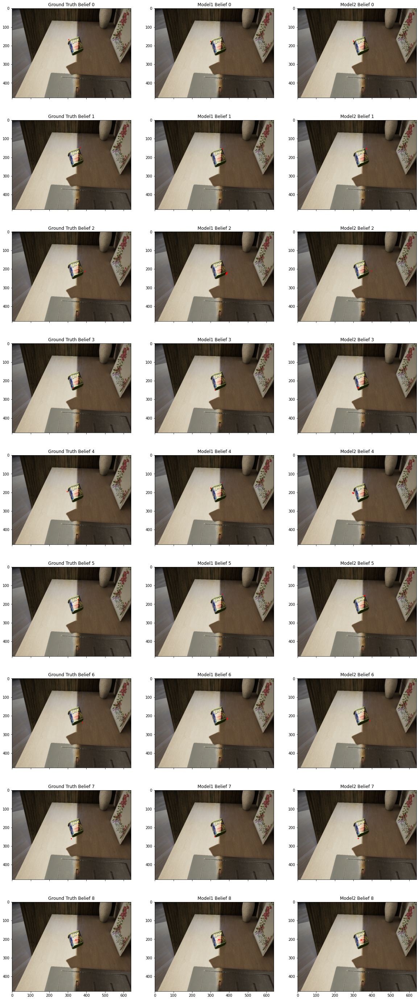

In [27]:
cascade_to_viz = -1 # Visualizing cascade 6's output. Feel free to change (-1 to -6)
image_tensor = transform(in_img)
image_torch = image_tensor.to(device).unsqueeze(0)

out, seg = model_1(image_torch)
beliefs_1 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only

out, seg = reshape_maps(model_2(image_torch))
beliefs_2 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only


compare_belief_maps(beliefsTruths, beliefs_1, beliefs_2, in_img)
print(f"DOPE WITH pretrained vgg, Epoch: {epoch_1}")
print(f"DOPE_2, Epoch: {epoch_2}")

### Predicted Belief Map Analysis

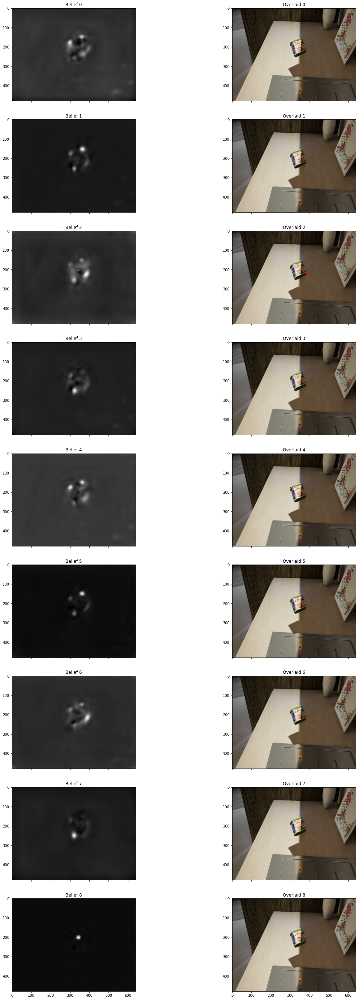

In [28]:
 viz_belief_maps(beliefs_1, in_img) # DOPE

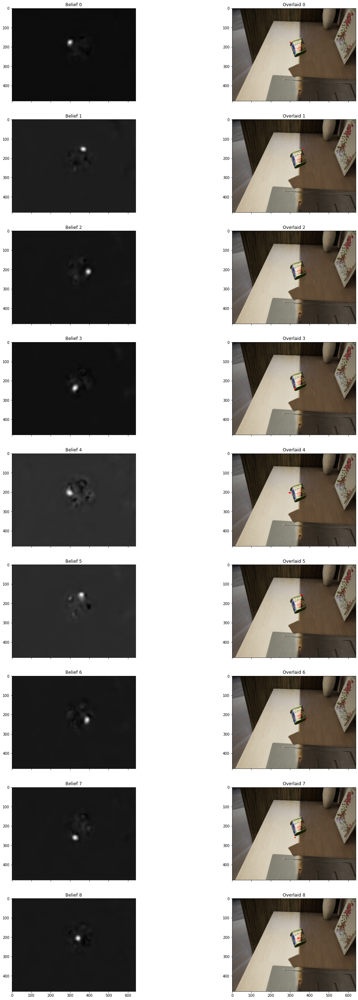

In [29]:
 viz_belief_maps(beliefs_2, in_img) # DOPE2 (single chain)

In can be concluded that, the predicted belief maps by DOPE_2 has more confusions compared to those of produced by DOPE. This is probably because of the reduced number of trainable parameters. Roughly, in terms of convergence, it seems like DOPE_2 is behind DOPE BY 40 epochs.

## DOPE v2.1 - Model Layers Modified for Optimization.
Architecture overview [video](https://youtu.be/KLQW8YP5lEI)  
My hypothesis was that DOPE has some inefficiencies in network design. I tried to change the network architecture to address that in this version 2.1.  

Notably I decided to include one more pretrained conv layer from vgg network. I kept the pretrained vgg layers in "self.vgg" block. I renamed the extra layers that is added after vgg as "feature" block. In DOPE_2, only 2 extra conv layers were added after original vgg structure. I assume the purpose of this addition was to come up with more non-linearity in input features to the cascades. I instead decided to add 10 conv layers in this "feature" block. In short, I extended the feature block so that compared to DOPE_2, the cascades would get more complicated/non-linear features as input to operate on.  

The other significant change was in the size of each cascade. In DOPE_2, the first cascade had 5 and the other 5 cascades had 7 conv layers. That is in total DOPE_2 had 40 conv layers for map/output generation. I decided to reduce the depth of each cascade in DOPE_2.1. In DOPE_2.1, I reduced the conv layer number to 4 each, making it total 24 for output map generation.  

The logic behind this design was analogous to how conv nets usually work with images. When a conv-net is give a 3-channel image, the first several conv layers only calculate basic features like edges, corners etc. With that analogy in mind, DOPE_2 is doing the same thing but with 128 channel input image to each of the cascades. Each cascade gets the same input image of 128 channel. It is my hypothesis that the first few layers of each cascade is used to calculate some form of "basic" features. In other words, my hypothesis is that first few layers do the same job in all cascades. The job is to come up with more non-linearity in the subsequent feature maps. In DOPE_2.1, I extended the feature calculation block, so that this common operation is done in the "feature" block once per input image, not 6 times as is the case in DOPE_2.  

Due to shortage of both time and my skills, I couldn't prepare visualizations of weights from the first few layers DOPE_2, to prove my hypothesis.

### Changes in Network:
![DOPE_2](docs/DOPE_2.png)
![DOPE_2.1](docs/DOPE_2.1.png)

In [15]:
epoch_1 = 60
epoch_2 = 60

# DOPE_2 - Single chain map generation insted of using seperate chains
network="DOPE_2"
net_path = "weights/dope2_meat/net_epoch_" + str(epoch_1) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_1 = model.net

# DOPE_2.1 - Single chain but with modified layer settings
network="DOPE_2.1"
net_path = "weights/dope2.1_meat/net_epoch_" + str(epoch_2) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_2 = model.net

print(model_2.eval())

dope2p1_param_count = count_parameters(model_2)
print('Parameter count: ' + str(dope2p1_param_count))

Loading model 'weights/dope2_meat/net_epoch_60.pth'...
    Model loaded in 1.891951084136963 seconds.
Loading model 'weights/dope2.1_meat/net_epoch_60.pth'...
Training network pretrained on imagenet.
    Model loaded in 2.1983137130737305 seconds.
DOPE_2p1(
  (vgg): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kerne

### Vertex Prediction Visualization
Visualizing vertex detection performance on input image.  
I compare performance with DOPE_2 only to observe changes. After observing both output looks identical.

DOPE_2, Epoch: 60
DOPE_2.1, Epoch: 60


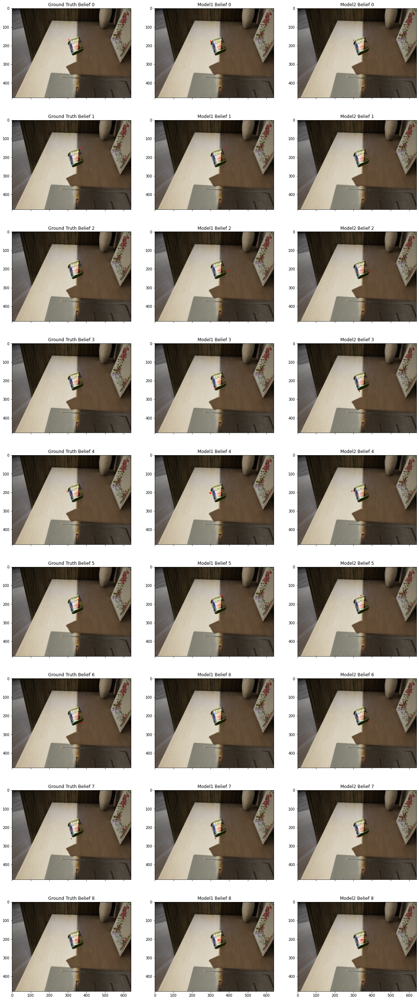

In [16]:
cascade_to_viz = -1 # Visualizing cascade 6's output. Feel free to change (-1 to -6)
image_tensor = transform(in_img)
image_torch = image_tensor.to(device).unsqueeze(0)

out, seg = reshape_maps(model_1(image_torch))
beliefs_1 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only

out, seg = reshape_maps(model_2(image_torch))
beliefs_2 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only


compare_belief_maps(beliefsTruths, beliefs_1, beliefs_2, in_img)
print(f"DOPE_2, Epoch: {epoch_2}")
print(f"DOPE_2.1, Epoch: {epoch_2}")

### Predicted Belief Map Analysis
In can be observed that, DOPE_2.1 is producing almost identical results as DOPE_2.

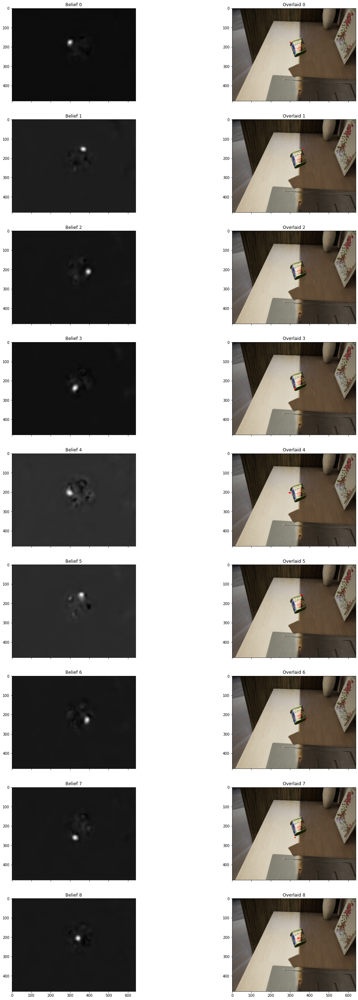

In [17]:
 viz_belief_maps(beliefs_1, in_img) # DOPE_2

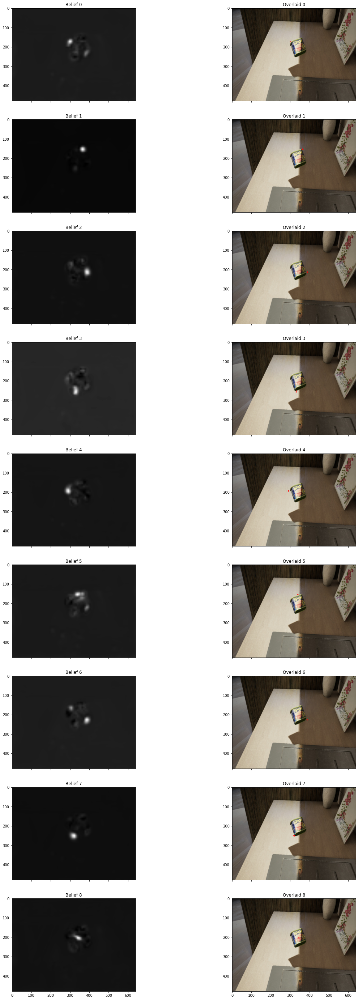

In [18]:
viz_belief_maps(beliefs_2, in_img) # DOPE_2.1

## ResNetPose
Architecture overview [video](https://youtu.be/Ohxr5tSP3z4)  
Following is the network architecture. I used transfer learning so I used pretrained weights of ResNet34. I froze layer 1 and layer 2 of the resnet34 as they are used for basic feature calculation and didn't want gradient calculation for them. I turned on gradient calculation only for layer 3, 4 and the cascades. The cascades are also designed to have Residual basicBlocks connections inside them. So, now this design is completely based on ResNet34 and all cascades have residual connections within.  
The objective of this design was faster convergence. First of all, ResNet utilizes batch normalization heavily. BatchNormalization makes it easier for NN to train on the feature maps as they are normalized. Also, it addresses the vanishing gradient problem in large networks.  
The second objective behind this design was better gradient flow. Due to residual connections, I was hoping of getting a better gradient flow in the cascades and subsequently a faster convergence.


### ResNetPose full Network Diagram:
![ResNetPose](docs/ResnetPose_part1.png)

### ResNetPose Zoomed Cascades Part:
![ResNetPose](docs/ResnetPose_part2.png)

In [19]:
# ResNetPose - ResNet34 based architecture
network="ResNetPose"
net_path = "weights/ResNetPose_meat/net_epoch_" + str(epoch_2) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_2 = model.net

cascade_to_viz = -1 # Visualizing cascade 6's output. Feel free to change (-1 to -6)
image_tensor = transform(in_img)
image_torch = image_tensor.to(device).unsqueeze(0)

out, seg = reshape_maps(model_2(image_torch))
beliefs_2 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only

print(model_2.eval())

resnetpose_param_count = count_parameters(model_2)
print('Parameter count: ' + str(resnetpose_param_count))

Loading model 'weights/ResNetPose_meat/net_epoch_60.pth'...
Loading pretrained ResNet34: True
Freezing entire ResNet34 except layer 3 and 4...
    Model loaded in 1.6994142532348633 seconds.
ResNetPose(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 

### Predicted Belief Map Analysis
It is clear that the ResNetPose didn't learn anything. I have tried out different learning rates but nothing worked. I intentionally trained these networks on 3k images, although I knew from my dev_batch test that this network architecture wouldn't converge.  
I can't figure out yet why this structure wouldn't work. This is not the only ResNet based architecture I have tried. I have tried out with atleast 4 different designs and even ResNet50. My conclusion was than any time I involved residual connections in my network, and batch normalizations, the network never converged. It didn't matter how long I train or what learning rate I chose. At one instance I ran the network for a day continuously with moderate learning rate. I also added adaptive learning rate decay from PtTorch. However, nothing seems to help converge the ResNet style architectures. I can't explain this behavior yet.

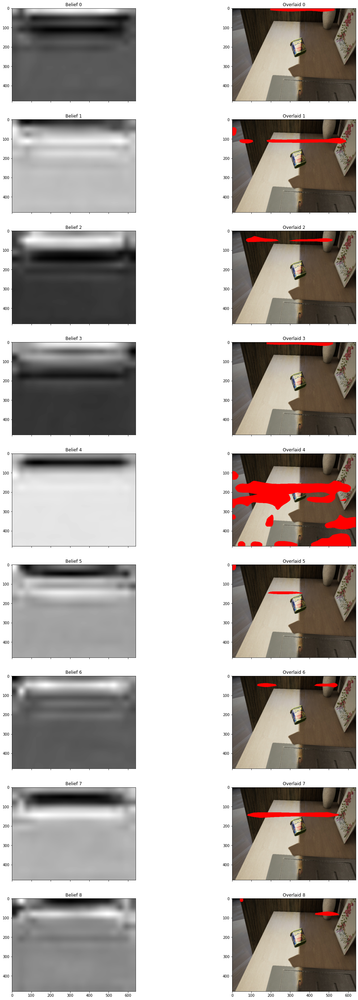

In [20]:
 viz_belief_maps(beliefs_2, in_img) # ResNetPose

## DOPE_2.2
Architecture overview [video](https://youtu.be/-D1yftut-Ys)  
In order to experiment whether BatchNormalizations were affecting training, I decided to add Batch Normalizations after each conv layer in DOPE_2.1. I also switched from vgg19 to vgg19_bn for feature calculation. The difference of vgg19_bn with vgg19 is the addition of BN layers between each pair of conv and ReLU layers. To keep the continuity in design, I intentionally used BN layers before ReLU. Following is how the network design looks like.

In [21]:
epoch_1 = 60
epoch_2 = 60

# DOPE_2.1 - no BN
network="DOPE_2.1"
net_path = "weights/dope2.1_meat/net_epoch_" + str(epoch_1) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_1 = model.net

# DOPE_2.2 - With BN
network="DOPE_2.2"
net_path = "weights/dope2.2_meat/net_epoch_" + str(epoch_2) + '.pth'
model = ModelData(name, net_path, gpu_id, network)
model.load_net_model()
model_2 = model.net


print(model_2.eval())

dope2p2_param_count = count_parameters(model_2)
print('Parameter count: ' + str(dope2p2_param_count))

Loading model 'weights/dope2.1_meat/net_epoch_60.pth'...
Training network pretrained on imagenet.
    Model loaded in 1.2716608047485352 seconds.
Loading model 'weights/dope2.2_meat/net_epoch_60.pth'...
Training network pretrained on imagenet.
    Model loaded in 2.258462905883789 seconds.
DOPE_2p2(
  (vgg): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(

### Predicted Belief Map Analysis
I compare DOPE_2.1 and DOPE_2.2 (batch normalized version of v2.1). 

In [22]:
cascade_to_viz = -1 # Visualizing cascade 6's output. Feel free to change (-1 to -6)
image_tensor = transform(in_img)
image_torch = image_tensor.to(device).unsqueeze(0)

out, seg = reshape_maps(model_1(image_torch))
beliefs_1 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only

out, seg = reshape_maps(model_2(image_torch))
beliefs_2 = out[cascade_to_viz][0].cpu() # Select the last cascade's output only

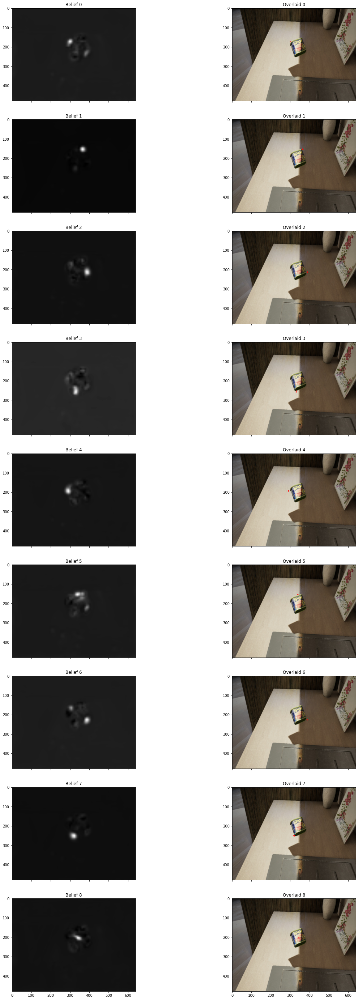

In [23]:
viz_belief_maps(beliefs_1, in_img) # DOPE_2.1

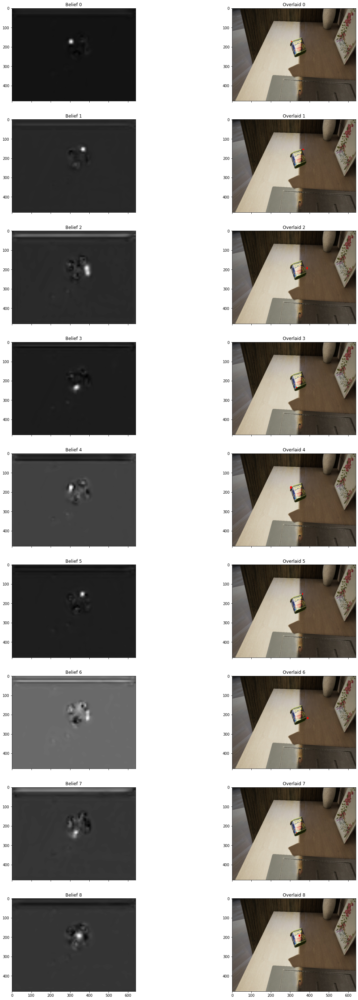

In [24]:
viz_belief_maps(beliefs_2, in_img) # DOPE_2.2

It can be seen that the belief maps produced by DOPE_2.2 is generally less confident (more bright) compared to DOPE_2.1. Conclusion after comparison is that, adding batchnormalization makes it harder to train the same network architecture but not impossible. This means that BN layers had a very little role to play in ResNetPose not converging. 

# Discussion
In this section I put my concluding remarks/observations.

## Learning Rate is the Most Important Hyperparameter
Although, I learned this same lesson in multiple deep learning courses, I didn't really realize its significance until I worked on this project. For about 2 weeks, I was trying out different architectures but didn't realize that different designs may require different learning rate too. As a result, even if I was using dev_batch, I often erroneously concluded that a network design won't converge/work just because of the design itself. However, later I realized that some of them would have worked if I had judiciously found out the proper learning rate first. I lost a lot of time like this.

## Using Adaptive Lr Decay is Harmful During Development Stage
In my training code, I kept an option to turn on LrScheduler [ReduceLROnPlateau](https://pytorch.org/docs/stable/optim.html#torch.optim.lr_scheduler.ReduceLROnPlateau) from PyTorch. It reduces learning rate when a metric has stopped improving. I used epoch loss metric. I started using this when I didn't yet realize the importance of determining the max-learning-rate for any new network architecture. By max rate, I mean a learning rate at which the loss explodes in the first or second epoch then goes down gradually.

Due to using ReduceLROnPlateau, I was starting out with a large initial learning rate. I had too much confidence on the Lr-scheduler. I knew that due to high learning rate I'll reach a plateau soon and the scheduler will automatically reduce the learning rate by 10 times. However, I later learned that this was a big mistake. Starting out with a large learning rate throws off the network training completely. Later on, even if the loss goes down eventually, most of the times, the network fails to learn anything useful. In short, starting out with high learning rate throws off training/learning completely and stops convergence. Thus my conclusion is that learning rate scheduler is for when all explorations are done and final selected network is to be trained for several days or weeks.

## The Pain of Slow Training/Experiment Iterations can be Eased by Smart Time Management and Some Tricks
The original authors of DOPE used [Nvidia-DGX](https://www.nvidia.com/en-us/data-center/dgx-systems/) work stations for 2 days. This workstation consists of 8 v100. That is worth near 100k dollars or more. So obviously I can't even imagine competing with that. However, while working on this project I did have to make the most utilization of my available resources. Here I am going to talk about that a little.  

Following are my system specs:  
Intel® Core™ i7-4770 CPU @ 3.40GHz × 8  
GPU-0: Nvidia Titan-Xp, 12 GB, 3840 cuda cores  
GPU-1: Nvidia Titan-X,  12 GB, 3584 cuda cores  

### Dataparallel
When I started out with this project, I initially ran training of a single network using [DataParallel](https://pytorch.org/tutorials/beginner/blitz/data_parallel_tutorial.html) of PyTorch. This approach distributes the training over multiple GPUs. However, the speed gain was negative. It was faster to train on a single GPU in comparison to DataParallel. I learned that the DataParallel method only works well when one has more than 3 GPUS and each GPU has large VRAM size (more than 12GB). The DataParallel implements a slave-master protocol, where the master GPU organizes everything and the slaves do the forward and backward passes. With 2 GPUs the communication overhead is way too much to see any speed gains.  


### Run 2 trainings simultaneously on 2 gpus and CPU bottleneck
I started training 2 networks simultaneously on the 2 different gpus. However, training time for each model doubled compared to if I ran them one at a time on my Titan-Xp. I realized the bottleneck is again data communication. But this time the bottleneck is my CPU. All 8 cores of my PC would be at 100%. This means that CPU can't load the training data fast enough.  

This observation drew my attention on CPU performance when I just run a single network on a single GPU. Even then all 8 cores of my CPUs stay at 100% constantly. This means even in single GPU - single training case, the CPU bottleneck exists and I have never reached the full computational speed of my GPUs. For me, this was a very useful and interesting observation. As till this point I believed that training time is mainly reliant on GPU's cuda core counts. Turns out that training time is initially dependent on CPU core count and frequency.  

### Use dev_batch for exploration
As described previously, usage of dev_batch helped me set initial learning rates and filter out network designs which would never work. As a result although I didn't have a DGX, I could still continue my hyperparameter exploration smoothly.

### Pause and continue large training sessions
I added a feature in the training code which I call "continue training". This feature helps me break out of an training session without loosing any training log data but which frees up all my computational resources. Later on I can just start training from my last epoch or any epoch of my choosing. This was useful when I have to sometimes train the network for 2-3 days continuously. Sometimes, I might want to stop the training to do some other research works. Once my other works are done and my desktop is free, I would just resume training from where I left off. This strategy was very useful in making sure my GPUs are always on job, and I could do more experiments.


## Much Difficult Problem to Solve than I Anticipated
Let's do a final comparison of the experimental models in terms of number of training-parameters and try to come up with some intuition.

In [25]:
print(f'DOPE param count:       {dope_param_count}')
print(f'DOPE2 param count:      {dope2_param_count}')
print(f'DOPE2.1 param count:    {dope2p1_param_count}')
print(f'DOPE2.2 param count:    {dope2p2_param_count}')
print(f'ResNetPose param count: {resnetpose_param_count}')

DOPE param count:       50267350
DOPE2 param count:      28818390
DOPE2.1 param count:    15629014
DOPE2.2 param count:    15647958
ResNetPose param count: 79295101


The first noticeable issue here is the number of trainable parameters in ResNetPose. The number of parameters ended up being ~30 million more than even original DOPE. Probably this is the reason why I couldn't converge this architecture. As having more training parameters means slower convergence. Due to shortage of time I could not train another model with lower number of parameters.  

Another, noticeable jump in param count happens from DOPE_2 TO DOPE_2.1; i.e. param count is almost halved. If we look at the belief maps in previous sections for both the models, they are quite identical. This indicates that my network structure optimization worked somewhat. Due to shortage of time I could not do more concrete experiments that would yield numerical results for accuracy comparison. I'll continue that in my personal research later on.  

I started this project out with the objective of coming up with a network architecture that is more efficient and faster than DOPE while loosing little accuracy. It seems that the network architecture variation is a hyperparameter optimization problem which is very time consuming and very challenging to solve. I couldn't come up with that final architecture. Nonetheless, the silver lining is that I acquired much deeper understanding and practical skills through this project. I have a more realistic idea about working with deep learning now.  

# Conclusion
In this project, I presented my experimentation with network design of DOPE. I have presented DOPE_2, DOPE_2.1, DOPE_2.2 and ResNetPose. Accurate seems to be degrading with the reduction in number of parameters. ResNet based design didn't work, but I assume it will, with some more experiments. In the project, I have also demonstrated the effects of transfer learning, and of using a small development batch (for faster hyperparameter exploration). Finally, I have presented my observations and learnings in the discussion section. Designing such a elaborate network to be functional is not an easy task for sure. It requires very good understanding and intuitions about conv nets and most importantly it requires a lot of time. I can confidently claim that, after working on this project for weeks, I am definitely better in Deep Learning, PyTorch, Python than I was a month ago. That is exactly what I wanted, so that is the takeaway for me... :)

Thank you, for checking out the project.